In [1]:
%load_ext autoreload
%autoreload 2
%matplotlib inline
%config InlineBackend.figure_format = 'retina'

In [2]:
import scanpy as sc 
import numpy as np 
import pandas as pd 
import seaborn as sns
import matplotlib.pyplot as plt
import os, sys 
sys.path.append('../../src')
import sys
import scanpy as sc
sys.path.append('/Users/koush/Projects/SpaceOracle/src/')
import celloracle as co

OMP: Info #276: omp_set_nested routine deprecated, please use omp_set_max_active_levels instead.


In [3]:
adata = sc.read_h5ad('/Users/koush/Desktop/training_data/mouse_kidney_13.h5ad')
adata

AnnData object with n_obs × n_vars = 8509 × 3058
    obs: 'ct1', 'ct2', 'ct3', 'ct4', 'cond', 'medulla_cortex', 'domain', 'cell_type', 'cell_type_int'
    uns: 'cell_type_colors', 'neighbors', 'pca', 'umap'
    obsm: 'X_pca', 'X_umap', 'spatial', 'spatial_unscaled'
    varm: 'PCs'
    layers: 'imputed_count', 'normalized_count', 'raw_count'
    obsp: 'connectivities', 'distances'

In [4]:
%matplotlib inline

In [5]:
xy = pd.DataFrame(adata.obsm['spatial'], columns=['x', 'y'], index=adata.obs_names)
df = xy.join(adata.obs).join(adata.to_df(layer='imputed_count'))

In [6]:
df = df[df.x > 500]

In [7]:
[i for i in df.ct3.value_counts().index if 'Mac' in i]

['Mac_2',
 'Mac_0',
 'Mac_3_TGFB3+',
 'Mac_4',
 'Mac_1_CellCycle+_1',
 'Mac_1_CellCycle+_0']

In [8]:
ct_interest = ['Mac_2',
 'Mac_0',
 'Mac_3_TGFB3+',
 'Mac_4',
 'Mac_1_CellCycle+_1',
 'Mac_1_CellCycle+_0']

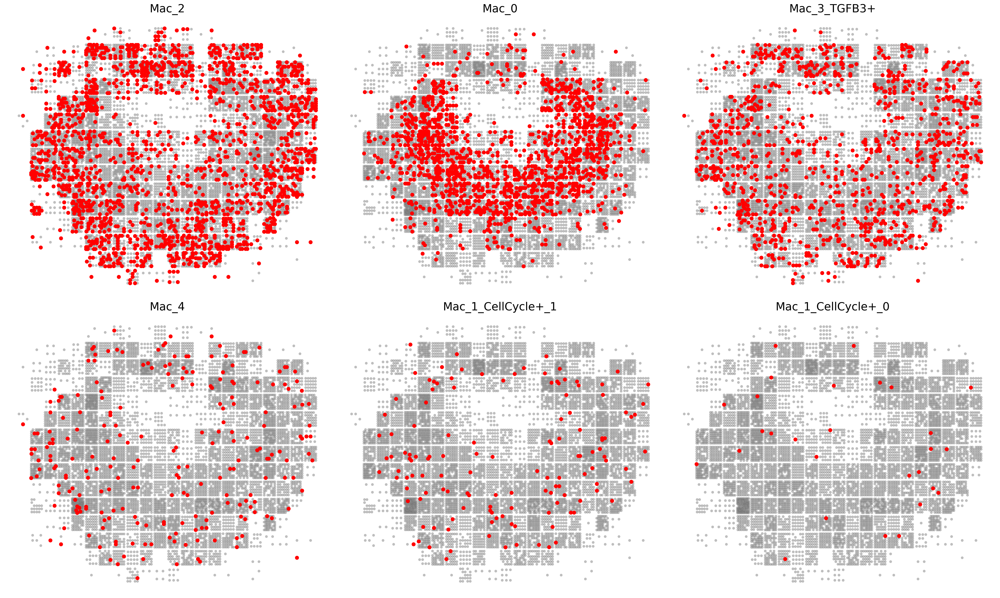

In [11]:
plt.rcParams['figure.figsize'] = (25, 15)
plt.rcParams['figure.dpi'] = 140

fig, axes = plt.subplots(2, 3)
axes = axes.flatten()

for i, cell_type in enumerate(ct_interest):
    ax = axes[i]
    df_ = df[df['ct3'] == cell_type]
    
    ax.scatter(
        df['x'], df['y'],
        c='grey',
        alpha=0.5,
        s=20, marker='o',
        linewidth=0.1, edgecolor='black',
    )

    ax.scatter(
        df_['x'], df_['y'],
        c='red',
        s=50, marker='o',
        linewidth=0.0, edgecolor='black',
    )
    
    ax.set_axis_off()
    ax.set_title(cell_type, fontsize=20)

plt.tight_layout()
plt.show()

In [ ]:
osmogenes = ['Aqp2', 'Aqp4', 'Cryab', 'Elf5', 'Mal', 'Muc1',
        'Pax2', 'Sgk1', 'Slc14a2', 'Slc5a3']
hypoxia = ['Anxa2', 'Btg1', 'Cdkn1b', 'Ddit3', 'Hexa', 'Hoxb9', 'Hspa5', 'Tes']
markers = ['Wt1', 'Nphs2', 'Sord', 'Cyp2e1', 'Lrp2', 'Bst1', 'Slc4a11', 'Slc12a1', 
        'Umod', 'Slc12a3', 'Calb1', 'Aqp2', 'Aqp4']
nephron = ['Cldn1', 'Spp2', 'Lrp2', 'Aqp1', 'Sptssb', 'Slc12a1', 'Slc12a3', 'Calb1']
collecting_duct = ['Hsd11b2', 'Aqp4', 'Aqp2', 'Atp6v1g3', 'Gata3', 'Calb1']
vascular = ['Kdr', 'Cdh5', 'Vegfa', 'Emcn', 'Podxl']
hema = ['Cd52', 'Fcer1g']
immune = ['Thy1', 'Cd79a', 'Pax5']
stroma = ['Col1a1', 'Meis1', 'Postn']
podocyte = ['Pax8', 'Nphs1', 'Podxl', 'Meis1', 'Aldh1a2']

In [28]:
[i for i in adata.var_names if 'xy' in i]

['Gxylt2', 'Fxyd4', 'Fxyd1', 'Fxyd6', 'Fxyd2', 'Pxylp1']

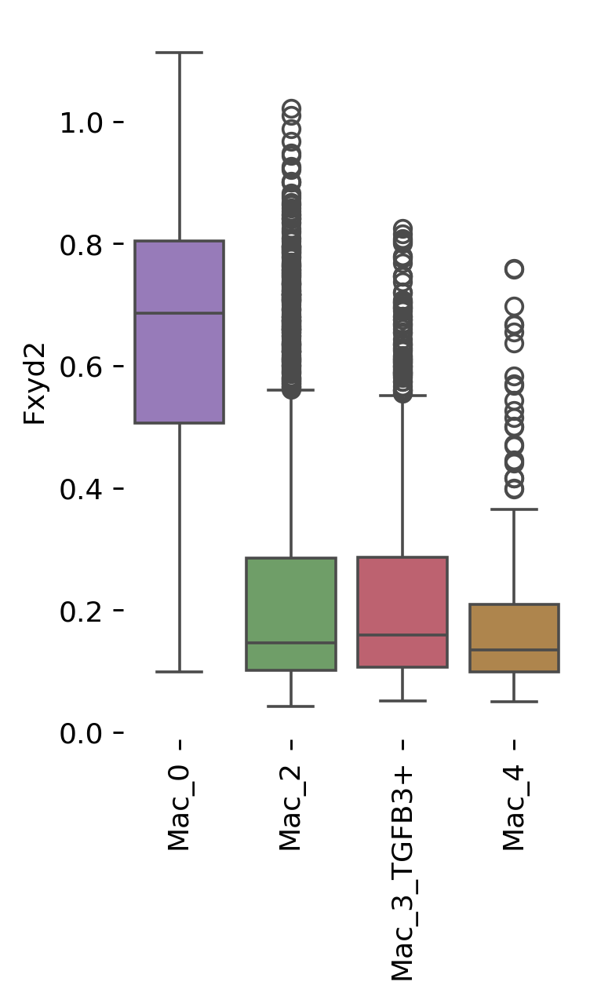

In [52]:
df = adata.to_df(layer='imputed_count').join(adata.obs['ct3'])[['Fxyd2', 'ct3']].query(
    'ct3.isin(["Mac_0", "Mac_2", "Mac_3_TGFB3+", "Mac_4"])')
df.ct3 = df.ct3.astype('string')

plt.figure(figsize=(3, 5))
sns.boxplot(data=df, x='ct3', y='Fxyd2', 
    palette=["#9671c3",
"#69a75f",
"#cc5366",
"#be883d"])
plt.xticks(rotation=90)
plt.xlabel('')
plt.box(False)
plt.tight_layout()
plt.show()

In [75]:
from spaceoracle.tools.network import RegulatoryFactory
co_grn = RegulatoryFactory(
    colinks_path='/Users/koush/Desktop/training_data/mouse_kidney_13_colinks.pkl',
    annot='cell_type_int'
)

In [76]:
from spaceoracle.models.parallel_estimators import *

cell_threshes = pd.read_parquet(
    '/Users/koush/Desktop/training_data/mouse_kidney_13_LRs.parquet')
adata.uns['cell_thresholds'] = cell_threshes
adata.uns['cell_thresholds'].shape

(8509, 196)

In [77]:
from spaceoracle.models.parallel_estimators import SpatialCellularProgramsEstimator

estimator = SpatialCellularProgramsEstimator(
    adata=adata,
    target_gene='Cd74',
    layer='imputed_count',
    cluster_annot='cell_type_int', 
    grn=co_grn,
    radius=100,
    contact_distance=30,
)

In [78]:
# estimator.plot_modulators()

In [80]:
estimator.fit(num_epochs=50, learning_rate=5e-3, score_threshold=0.1)

Fitting Cd74 with 407 modulators
	25 Transcription Factors
	325 Ligand-Receptor Pairs
	57 TranscriptionFactor-Ligand Pairs
0: 0.9938 | 0.9947
1: 0.8992 | 0.8990
2: 0.9572 | 0.9438
3: 0.9276 | 0.9233
4: 0.9617 | 0.9582
5: 0.4338 | 0.4251
6: 0.9343 | 0.9427


In [81]:
betadata = estimator.betadata

In [84]:
bdf = betadata.join(xy).join(adata.obs)

In [86]:
bdf.columns

Index(['beta0', 'beta_Ahr', 'beta_Atf3', 'beta_Bcl11a', 'beta_Bcl11b',
       'beta_Bhlhe40', 'beta_Cebpb', 'beta_Ddit3', 'beta_E2f3', 'beta_Ebf1',
       ...
       'y', 'ct1', 'ct2', 'ct3', 'ct4', 'cond', 'medulla_cortex', 'domain',
       'cell_type', 'cell_type_int'],
      dtype='object', length=419)

In [113]:
df_.columns[:30]

Index(['beta0', 'beta_Ahr', 'beta_Atf3', 'beta_Bcl11a', 'beta_Bcl11b',
       'beta_Bhlhe40', 'beta_Cebpb', 'beta_Ddit3', 'beta_E2f3', 'beta_Ebf1',
       'beta_Egr1', 'beta_Esrra', 'beta_Ets1', 'beta_Hnf4a', 'beta_Hsf2',
       'beta_Irf4', 'beta_Klf6', 'beta_Nr3c1', 'beta_Pax5', 'beta_Polr2a',
       'beta_Ppara', 'beta_Ppargc1a', 'beta_Prdm16', 'beta_Prdm9', 'beta_Rbpj',
       'beta_Rel', 'beta_Tgfb2$Tgfbr1', 'beta_Tgfb3$Tgfbr1',
       'beta_Bmp2$Bmpr1b', 'beta_Bmp6$Bmpr1b'],
      dtype='object')

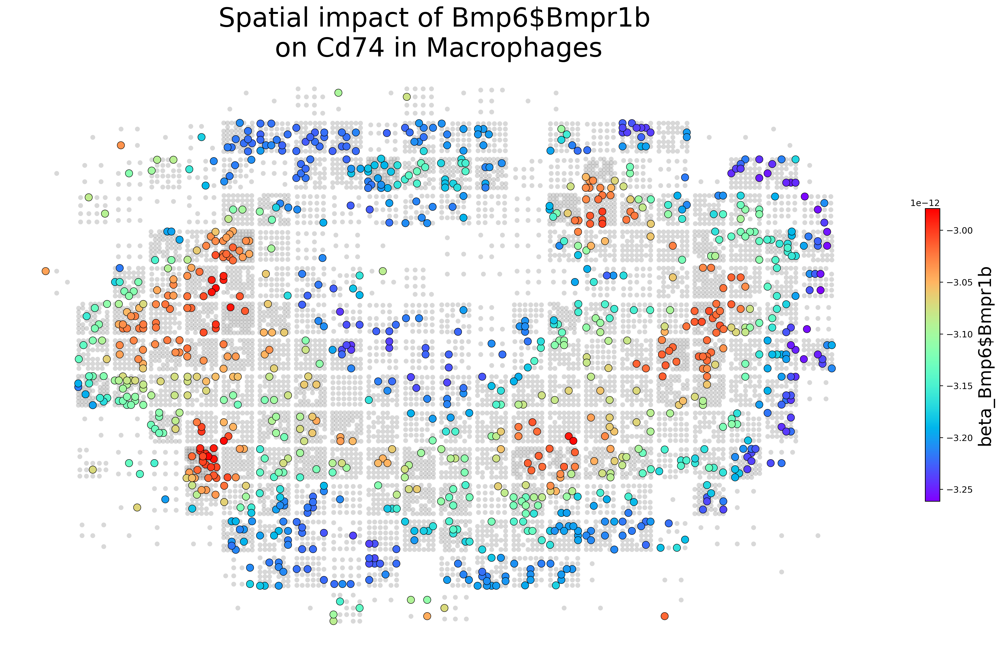

In [150]:
plt.rcParams['figure.figsize'] = (22, 12)
plt.rcParams['figure.dpi'] = 130

df_ = bdf[bdf['ct3'] == 'Mac_3_TGFB3+']
# df_ = bdf[bdf['ct3'] == 'Th17']
# df_ = bdf[bdf['ct3'] == 'B']
# df_ = bdf
df_ = df_[df_.x > 500]

target = 'beta_Bmp6$Bmpr1b'

fig, ax = plt.subplots()

ax.scatter(
    df['x'], df['y'],
    c='grey',
    alpha=0.3,
    s=30, marker='o',
    cmap='rainbow', linewidth=0.0, edgecolor='black'
)

scatter = ax.scatter(
    df_['x'], df_['y'],
    c=df_[target],
    s=70, marker='o',
    cmap='rainbow', linewidth=0.5, edgecolor='black'
)

ax.set_axis_off()
cbar = plt.colorbar(scatter, shrink=0.5)
cbar.set_label(target, fontsize=20)
plt.title(f'Spatial impact of {target.replace("beta_", "")} \non Cd74 in Macrophages', fontsize=30)
# plt.tight_layout()
plt.show()

In [158]:
from spaceoracle.prophets import Prophet
from spaceoracle.plotting.cartography import xy_from_adata
from spaceoracle.plotting.cartography import Cartography

In [179]:
adata.layers['Cd74'] = pd.read_parquet('/tmp/mouse_kidney_13/Cd74_2n_0x.parquet')
adata.layers['Pax5'] = pd.read_parquet('/tmp/mouse_kidney_13/Pax5_2n_0x.parquet')
adata.layers['Tgfb3'] = pd.read_parquet('/tmp/mouse_kidney_13/Tgfb3_2n_0x.parquet')

In [176]:
colors = ["#a6a5e8",
"#72be3e",
"#994dcc",
"#40c85d",
"#b332a3",
"#42952e",
"#d171e5",
"#a5bb36",
"#645ed0",
"#c5af3c",
"#5983e9",
"#e39c39",
"#3f64b2",
"#e56636",
"#4cbee0",
"#e2494f",
"#4ed1c3",
"#e73f77",
"#5bb767",
"#e85ec3",
"#3f7c33",
"#cf4696",
"#5fc695",
"#964aa1",
"#75902f",
"#a981e3",
"#4d661f",
"#dc85d1",
"#327243",
"#af356e",
"#93b66b",
"#72589f",
"#8f812b",
"#529bda",
"#b33b24",
"#31a49d",
"#bc3a53",
"#49996f",
"#e580a8",
"#1a6447",
"#ca92c9",
"#b56f20",
"#3d6ba0",
"#bdb26f",
"#7e7fc1",
"#665e1d",
"#a05d8f",
"#2f7b63",
"#e17e7d",
"#7e8149",
"#914665",
"#db9869",
"#a35053",
"#9a5e32"]

In [177]:
color_dict = dict(zip(adata.obs['ct2'].unique(), colors))
len(color_dict)

21

In [168]:
chart = Cartography(adata, color_dict)

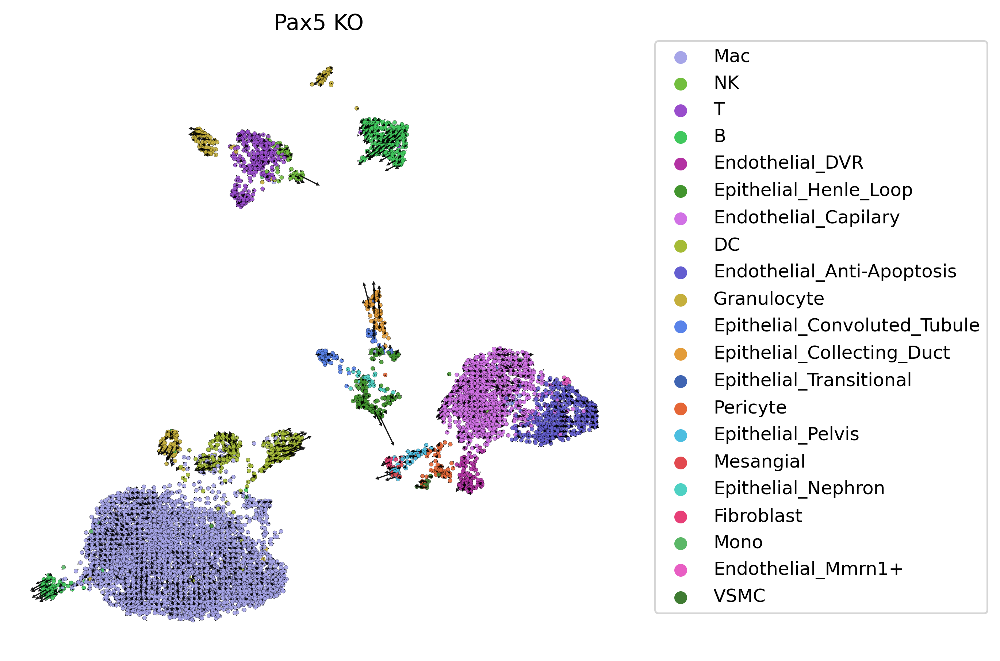

In [184]:
ax = chart.plot_umap_quiver(
    perturb_target='Pax5',
    grid_scale=2,
    vector_scale=1,
    figsize=(6, 6), 
    hue='ct2',
    legend_on_loc=False
)
plt.title('Pax5 KO')
plt.show()

In [27]:
estimator.betadata.to_parquet(f'./models/{estimator.target_gene}_betadata.parquet')

In [28]:
from spaceoracle.prophets import Prophet

In [29]:
pythia = Prophet(
    adata=estimator.adata,
    models_dir='./models',
    annot='cell_type_int',
    annot_labels='cell_type'
)

In [30]:
gex_df = estimator.adata.to_df(layer=estimator.layer)
pythia.compute_betas()
beta_dict = pythia._get_wbetas_dict(pythia.beta_dict, pythia.adata.layers['imputed_count'])
wbetas = beta_dict.data[estimator.target_gene].wbetas
xy = beta_dict.xydf.copy()
xy.columns = ['x', 'y']
df = wbetas \
        .join(estimator.adata.obs) \
        .join(xy) \
        .join(gex_df)

Interactions: 100%|██████████| 2/2 [00:00<00:00, 23.82it/s]


In [31]:
import anndata as ad
import pandas as pd

In [32]:
df['cell_type'].unique()

[2, 0, 5, 6, 3, 1, 4]
Categories (7, int8): [0, 1, 2, 3, 4, 5, 6]

In [48]:
estimator.receptors

['Tgfbr1',
 'Tgfbr1',
 'Bmpr1b',
 'Bmpr1b',
 'Fzd5',
 'Fzd5',
 'Egfr',
 'Egfr',
 'Egfr',
 'Erbb4',
 'Egfr',
 'Erbb4',
 'Erbb4',
 'Erbb4',
 'Erbb4',
 'Itgav',
 'Itgb3',
 'Pdgfra',
 'Pdgfrb',
 'Flt1',
 'Kdr',
 'Kdr',
 'Itgav',
 'Itgb3',
 'Aplnr',
 'Ccr1',
 'Ccr1',
 'Ccr1',
 'Ccr1',
 'Ccr2',
 'Ccr2',
 'Ccr2',
 'Ccr2',
 'Ccr5',
 'Ccr5',
 'Ccr5',
 'Cxcr2',
 'Cxcr2',
 'Cxcr3',
 'Cxcr3',
 'Cxcr3',
 'Cxcr4',
 'Ackr3',
 'Cd74',
 'Cxcr4',
 'Cd44',
 'Cxcr2',
 'Ackr3',
 'Xcr1',
 'Il27ra',
 'Il1r1',
 'Il1rap',
 'Il17ra',
 'Tnfrsf1b',
 'Fas',
 'Tnfrsf9',
 'Itgb3',
 'Itgam',
 'Cd44',
 'Itgav',
 'Itgb3',
 'Itgb6',
 'Itga4',
 'Itga8',
 'Tek',
 'Tek',
 'Sdc1',
 'Sdc4',
 'Itga4',
 'Lrp1',
 'Sdc1',
 'Sdc4',
 'Itgav',
 'Itgb3',
 'Cr2',
 'Itgam',
 'Itgax',
 'Ednrb',
 'F2r',
 'Pard3',
 'Kit',
 'Met',
 'Ntrk3',
 'Nrp1',
 'Plxna2',
 'Plxna3',
 'Nrp1',
 'Plxna2',
 'Plxna3',
 'Nrp1',
 'Plxna2',
 'Plxna3',
 'Nrp2',
 'Nrp2',
 'Nrp2',
 'Plxna2',
 'Plxna3',
 'Fpr2',
 'Fpr1',
 'Aplnr',
 'Calcrl',
 'Gucy2c',
 'Tnfrsf1

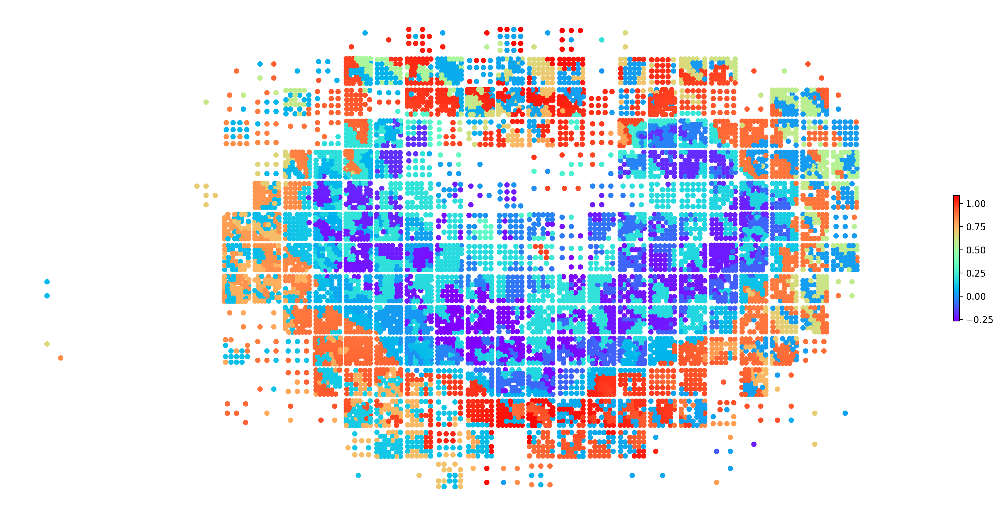

: 

In [50]:
plt.rcParams['figure.figsize'] = (22, 10)
plt.rcParams['figure.dpi'] = 100

fig, ax = plt.subplots()
scatter = ax.scatter(
    df['x'], df['y'],
    c=df['beta_Egfr'],
    s=35, marker='o',
    cmap='rainbow', linewidth=0.0, edgecolor='black'
)
ax.set_axis_off()

# Add colorbar
cbar = plt.colorbar(scatter, shrink=0.25)
# cbar.set_label('beta_Egfr')

plt.show()

In [185]:
df = betadata.join(xy)

In [191]:
betas = df[[i for i in df.columns if 'beta_' in i]].mean().sort_values()
selected_betas = pd.concat([betas.head(8), betas.tail(7)])

fig = plt.figure(figsize=(20, 18), dpi=200)

# Get global min/max for consistent colorbar scale
vmin = df[selected_betas.index].min().min()
vmax = df[selected_betas.index].max().max()
norm = plt.Normalize(vmin=vmin, vmax=vmax)

# Create subplot grid with space at bottom for colorbar
gs = plt.GridSpec(4, 5, height_ratios=[1, 1, 1, 0.1])

for idx, b in enumerate(selected_betas.index):
    ax = plt.subplot(gs[idx//5, idx%5])
    
    scatter = sns.scatterplot(
        data=df, 
        x='y', y='x', 
        hue=b,
        size=0.1,
        alpha=1,
        edgecolor='black',
        linewidth=0.0,
        palette='rainbow',
        ax=ax)
    
    ax.set_title(b, fontsize=20)
    ax.get_legend().remove()
    ax.set_xticks([])
    ax.set_yticks([])
    ax.set_xlabel('')
    ax.set_ylabel('')
    ax.spines['top'].set_visible(False)
    ax.spines['right'].set_visible(False) 
    ax.spines['bottom'].set_visible(False)
    ax.spines['left'].set_visible(False)

# Add single colorbar at bottom
cbar_ax = plt.subplot(gs[3, :])
plt.colorbar(
    plt.cm.ScalarMappable(norm=norm, cmap='rainbow'),
    cax=cbar_ax,
    orientation='horizontal',
    label='Beta Value',
    shrink=0.5
)

plt.tight_layout()
plt.show()

In [1]:
import matplotlib

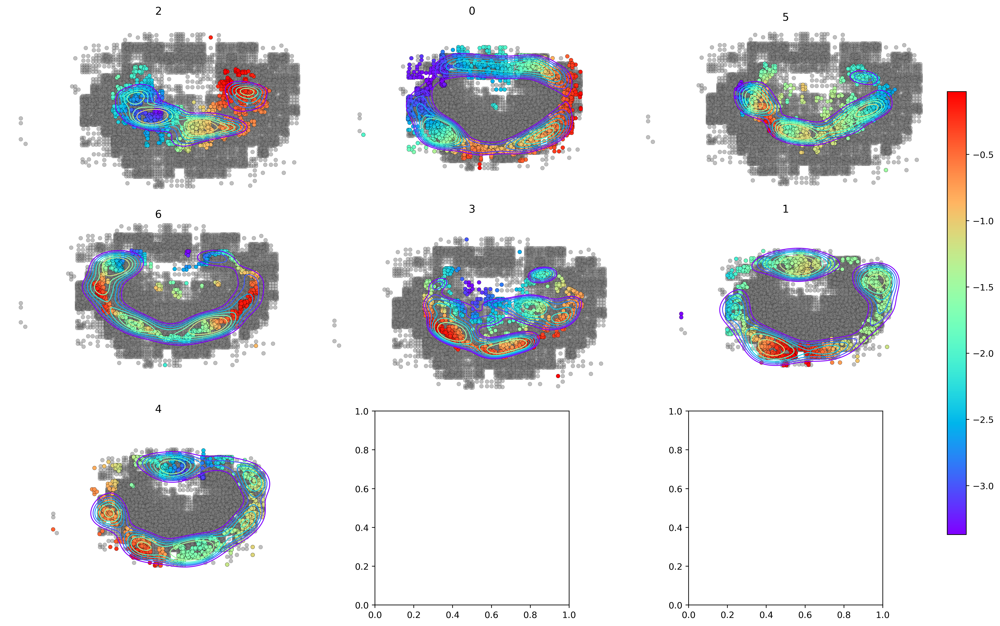

In [49]:
from mpl_toolkits.axes_grid1 import make_axes_locatable

plt.rcParams['figure.figsize'] = (9, 9)
plt.rcParams['figure.dpi'] = 140

modulator = 'E2f3'
cell_types = df['cell_type'].unique()

n_cells = len(cell_types)

# Create a grid of subplots
n_cols = 3
s = 20
n_rows = (n_cells + n_cols - 1) // n_cols
fig, axes = plt.subplots(n_rows, n_cols, figsize=(15, 10), dpi=200)
axes = axes.flatten()


# Create a single colorbar that will be used for all plots
norm = plt.Normalize(df[f'beta_{modulator}'].min(), df[f'beta_{modulator}'].max())
sm = plt.cm.ScalarMappable(cmap='rainbow', norm=norm)

for i, cell_type in enumerate(cell_types):
    # Plot other cells in grey
    sns.scatterplot(
        data=df[df['cell_type'] != cell_type],
        x='x',
        y='y',
        color='grey',
        s=s,
        linewidth=0.2,
        alpha=0.5,
        edgecolor='black',
        legend=False,
        ax=axes[i]
    )

    # Plot target cell type colored by modulator
    scatter = sns.scatterplot(
        data=df[df['cell_type'] == cell_type],
        x='x',
        y='y',
        hue=f'beta_{modulator}',
        palette='rainbow',
        s=s,
        linewidth=0.2,
        edgecolor='black',
        legend=False,
        ax=axes[i]
    )

    # Add contour plot
    cell_type_data = df[df['cell_type'] == cell_type]
    sns.kdeplot(
        data=cell_type_data,
        x='x',
        y='y',
        levels=7,
        linewidths=1,
        alpha=1,
        cmap='rainbow',
        fill=False,
        ax=axes[i],
        thresh=0.4  # Add threshold to remove the lowest contour
    )
    axes[i].set_title(cell_type)
    axes[i].set_axis_off()
    
    # Set equal aspect ratio to prevent distortion
    axes[i].set_aspect('equal')

# # Remove empty subplots if any
# for j in range(i+1, len(axes)):
#     fig.delaxes(axes[j])

# Add a single colorbar to the right of the entire figure
cbar_ax = fig.add_axes([1, 0.15, 0.02, 0.7])
plt.colorbar(sm, cax=cbar_ax, orientation='vertical', shrink=1)

for ax in axes:
    ax.set_aspect('equal')

plt.tight_layout()
plt.show()